# Reviews are KING - Project Notebook

#### Team members: Shengzhao LEI - Tao SUN -  Xiangzhe MENG

Website of our group: [Reviews Are KING](https://xiangzhemeng.github.io)

Some plots are not avaliable in the notebook, please go to [Jupyter NBViewer](https://nbviewer.jupyter.org/gist/TaoSunVoyage/2319dfa47c3e73490b027fb635bede07)

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
pd.options.mode.chained_assignment = None

In [2]:
import plotly
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.tools as tls

import cufflinks as cf
cf.set_config_file(offline=True, world_readable=True, theme='white')

color='YlGnBu'
color_list = ['rgb(199, 233, 180)','rgb(127, 205, 187)','rgb(65, 182, 196)',
              'rgb(29, 145, 192)','rgb(34, 94, 168)','rgb(37, 52, 148)']

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

# 1 - Data preprocessing

## 1.1 - Load Kindle store product data

In [3]:
df_kindle_meta = pd.read_pickle('pickleDataNew/previous_data/kindle_metadata.pkl')
print("After data cleaning, there remains {} kindle store products, all of these products possess at least 5 reviews in reciew dataset.".format(df_kindle_meta.shape[0]))

After data cleaning, there remains 61682 kindle store products, all of these products possess at least 5 reviews in reciew dataset.


We notice that the categories of products in Amazon are hierarchical. And each book may belong to several different categories. So, we need to change the format of categories in our dataset.

The cell below is an example of the category for a product.

In [4]:
df_kindle_meta.iloc[0].categories

[['Books', 'Literature & Fiction'],
 ['Books', 'Mystery, Thriller & Suspense', 'Thrillers & Suspense', 'Suspense'],
 ['Kindle Store', 'Kindle eBooks', 'Mystery, Thriller & Suspense', 'Suspense']]

## 1.2 - Reshape Kindle product and review dataframe by category

Below is the process of reshaping the category information. We want to unzip the hierarchical category in order to analyze the category of each book directly. We find that for all kindle books, the first category must be **Kindle Store** which we don't need.

In [5]:
kindle_cat = []
for idx in df_kindle_meta.index:
    cat = df_kindle_meta.loc[idx].categories
    for catcat in cat:
        if catcat[0]=='Kindle Store':
            kindle_cat.append([idx]+catcat[1:])
        else:
            kindle_cat.append([idx]+catcat)

In [6]:
df_kindle_category = pd.DataFrame(kindle_cat)
df_kindle_category.columns = ['asin','1st','2nd','3rd','4th','5th','6th','7th']
df_kindle_category.set_index('asin',inplace=True)
df_kindle_category.head()

,1st,2nd,3rd,4th,5th,6th,7th
asin,,,,,,,
B000F83SZQ,Books,Literature & Fiction,None,None,None,None,None
B000F83SZQ,Books,"Mystery, Thriller & Suspense",Thrillers & Suspense,Suspense,None,None,None
B000F83SZQ,Kindle eBooks,"Mystery, Thriller & Suspense",Suspense,None,None,None,None
B000FA64QO,Books,Literature & Fiction,Genre Fiction,Movie Tie-Ins,None,None,None
B000FA64QO,Books,Science Fiction & Fantasy,Science Fiction,Space Opera,None,None,None


Now, let's do some very basic analysis about our category information. Here is a brief description/summary of all the categories present in the dataframe and the number of products for each category.

In [7]:
df_kindle_category['1st'].value_counts()

Kindle eBooks         145691
Books                 143778
Kindle Short Reads     24078
Kindle Singles           338
Kindle Worlds             70
Sports & Outdoors          1
TestNode                   1
Toys & Games               1
Name: 1st, dtype: int64

`1st` column of the dataframe category represents the biggest groups that the book belongs to.

Out of our surprise, besides **Books** and **Kindle eBooks**, there are other categories, like **Kindle Short Reads**, which is very creative and interesting kindle product and we have a large amount of reviews/metadata related to it. We can also do some extra analysis on this category. So, we decide to keep it.

After observing the whole dataframe and the category structure, we decide to use two categories **Books** and **Kindle Short Reads** for our project.

### 1.2.1 - SubCategories of Kindle book products

In this part, we collect all kindle products with category **Books** and classify these products with the sub-categories shown below. The cell give us the number of products for each category as well.

In [8]:
df_kindle_category[df_kindle_category['1st'] == 'Books']['2nd'].value_counts()

Literature & Fiction            47074
Romance                         35096
Science Fiction & Fantasy       10514
Mystery, Thriller & Suspense     9633
Health, Fitness & Dieting        4946
Children's Books                 4590
Cookbooks, Food & Wine           4547
Gay & Lesbian                    4060
Self-Help                        3036
Teen & Young Adult               2758
Business & Money                 2515
Christian Books & Bibles         2483
Religion & Spirituality          2437
Crafts, Hobbies & Home           1569
Reference                        1325
Humor & Entertainment            1106
Biographies & Memoirs            1016
Parenting & Relationships         894
Computers & Technology            752
Travel                            496
History                           488
Education & Teaching              420
Politics & Social Sciences        369
Arts & Photography                366
Medical Books                     353
Sports & Outdoors                 342
Science & Ma

In [17]:
df_cat = pd.DataFrame(df_kindle_category[df_kindle_category['1st'] == 'Books']['2nd'])
df_cat.columns = ['category']
df_cat_price = pd.merge(pd.DataFrame(df_kindle_meta['price']),df_cat,left_index=True,right_index=True,how='inner')

df_kindle_review = pd.read_pickle('pickleDataNew/previous_data/kindle_review.pkl')
df_kindle_book_review = pd.merge(df_kindle_review, df_cat_price,left_index=True,right_index=True,how='inner')
df_kindle_book_review.head()

,helpful,reviewText,overall,summary,unixReviewTime,price,category
asin,,,,,,,
B000F83SZQ,"[0, 0]",I enjoy vintage books and movies so I enjoyed ...,5.0,Nice vintage story,2014-05-05,0.0,Literature & Fiction
B000F83SZQ,"[0, 0]",I enjoy vintage books and movies so I enjoyed ...,5.0,Nice vintage story,2014-05-05,0.0,"Mystery, Thriller & Suspense"
B000F83SZQ,"[2, 2]",This book is a reissue of an old one; the auth...,4.0,Different...,2014-01-06,0.0,Literature & Fiction
B000F83SZQ,"[2, 2]",This book is a reissue of an old one; the auth...,4.0,Different...,2014-01-06,0.0,"Mystery, Thriller & Suspense"
B000F83SZQ,"[2, 2]",This was a fairly interesting read. It had ol...,4.0,Oldie,2014-04-04,0.0,Literature & Fiction


### 1.2.2 - SubCategories of Kindle short read products

In this part, we collect all kindle products with category **Kindle Short Reads** and classify these products with these 6 sub-categories shown below. The cell give us the number of products for each category as well.

In [10]:
df_kindle_category[df_kindle_category['1st'] == 'Kindle Short Reads']['2nd'].value_counts()

Two hours or more (65-100 pages)    7742
90 minutes (44-64 pages)            5980
45 minutes (22-32 pages)            3982
One hour (33-43 pages)              3980
30 minutes (12-21 pages)            2001
15 minutes (1-11 pages)              393
Name: 2nd, dtype: int64

In this part, we select all metadata of the kindle short reads product and create a new dataframe **df_kindle_short_read_meta**.

In [11]:
# Collect all kindle short read product asin
asin_kindle_short_read = df_kindle_category[df_kindle_category['1st'] == 'Kindle Short Reads']
asin_kindle_short_read = asin_kindle_short_read.filter(items = ['2nd'], axis = 1)
asin_kindle_short_read = asin_kindle_short_read.reset_index()
asin_kindle_short_read = asin_kindle_short_read.drop_duplicates(subset = 'asin')
asin_kindle_short_read = asin_kindle_short_read.set_index('asin')

# Collect all kindle short read products
df_kindle_short_read_meta = df_kindle_meta.loc[list(asin_kindle_short_read.index)]
df_kindle_short_read_meta = df_kindle_short_read_meta.drop(['categories'],axis = 1)

# Add sub-category for each product
df_kindle_short_read_meta = df_kindle_short_read_meta.merge(asin_kindle_short_read,left_index=True, right_index=True,how="inner")
df_kindle_short_read_meta.columns = ['price','category']

# Merge kindle short read product and review dataframe
df_kindle_review = pd.read_pickle("pickleDataNew/previous_data/kindle_review.pkl")
df_kindle_short_read_review = df_kindle_review.merge(df_kindle_short_read_meta,left_index=True, right_index=True,how="inner")
df_kindle_short_read_review.to_pickle("pickleDataNew/kindle_short_read_review.pkl")
df_kindle_short_read_review.head()

,helpful,reviewText,overall,summary,unixReviewTime,price,category
asin,,,,,,,
B000FBFMVG,"[0, 0]",Really shouldn't have Han Solo on the cover as...,5.0,An interesting short story.,2014-02-15,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[5, 5]",Originally published as an e-book coinciding w...,3.0,Short story featuring everyone's favorite Wookiee,2008-08-25,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[0, 1]",This book was a good idea. I have always wante...,4.0,Great,2013-04-01,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[0, 0]",Great short story. It gives a little more insi...,5.0,Another read,2014-01-02,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[0, 0]",I love anything with Chewbacca in it. Him and...,5.0,Love It,2013-10-11,1.99,Two hours or more (65-100 pages)


## 1.3 - Update overall by taking helpful rate into consideration

`helpful rate` is very interesting and we want to make use of it. It shows how useful and reliable one's review and rating is. So, we use `helpful rate` to modify the rating information of every review as following:

$$HelpfulRate = \begin{cases}\dfrac{\# Helpful}{\# Voting}& \# Voting \neq 0\\ 1& \# Voting = 0 \end{cases}$$


$$ModifiedRate = \begin{cases}Rate+1& Rate\leq2,HelpfulRate\leq\dfrac{1}{3}\\Rate-1& Rate\geq4, HelpfulRate\leq\dfrac{1}{3}\\Rate& \text{Otherwise}\end{cases}$$

We assume that overall rating is not reasonable if the helpful rate is smaller than 1/3. Thus, if the unreasonable overall is smaller than 2 we add 1 point to the overall. If the unreasonable overall is larger than 4 we substract 1 point to the overall.

We modify all of our rating information for kindle data and book data as well.

##### Kindle short read review

In [12]:
# Divide the column helpful into two parts
# up --> number of helpful votes
# total --> number of total votes
up = df_kindle_short_read_review['helpful'].apply(lambda x: x[0])
total = df_kindle_short_read_review['helpful'].apply(lambda x: x[1])
 
# Compute helpful rate
df_kindle_short_read_review['helpful rate'] = up/total

# Add helful rate column and fill the nan value with 1
df_kindle_short_read_review['helpful rate'] = df_kindle_short_read_review['helpful rate'].fillna(1).map('{:,.2f}'.format)

# Drop helpful column
df_kindle_short_read_review = df_kindle_short_read_review.drop(['helpful'],axis = 1)

# Change data type for overall and helpful rate columns
df_kindle_short_read_review['overall'] = df_kindle_short_read_review['overall'].astype(float)
df_kindle_short_read_review['helpful rate'] = df_kindle_short_read_review['helpful rate'].astype(float)

# Compute new rate
rate = []
for idx in range(df_kindle_short_read_review.shape[0]):
    if df_kindle_short_read_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_short_read_review.iloc[idx]['overall'] >= 4:
        rate.append(df_kindle_short_read_review.iloc[idx]['overall'] - 1)
    elif df_kindle_short_read_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_short_read_review.iloc[idx]['overall'] <= 2:
        rate.append(df_kindle_short_read_review.iloc[idx]['overall'] + 1)
    else:
        rate.append(df_kindle_short_read_review.iloc[idx]['overall'])
        
# Add rate column        
df_kindle_short_read_review['rate'] = rate

# Drop overall and helpful rate colum
df_kindle_short_read_review = df_kindle_short_read_review.drop(['overall','helpful rate'],axis = 1)

# Reorder columns
df_kindle_short_read_review = df_kindle_short_read_review[['category','rate','price','summary','reviewText','unixReviewTime']]

# Update pickle file
df_kindle_short_read_review.to_pickle("pickleDataNew/kindle_short_read_review.pkl")

##### Kindle book review

In [18]:
# Divide the column helpful into two parts
# up --> number of helpful votes
# total --> number of total votes
up = df_kindle_book_review['helpful'].apply(lambda x: x[0])
total = df_kindle_book_review['helpful'].apply(lambda x: x[1])

# Compute helpful rate
df_kindle_book_review['helpful rate'] = up/total

# Add helful rate column and fill the nan value with 1
df_kindle_book_review['helpful rate'] = df_kindle_book_review['helpful rate'].fillna(1).map('{:,.2f}'.format)

# Drop helpful column
df_kindle_book_review = df_kindle_book_review.drop(['helpful'],axis = 1)

# Change data type for overall and helpful rate columns
df_kindle_book_review['overall'] = df_kindle_book_review['overall'].astype(float)
df_kindle_book_review['helpful rate'] = df_kindle_book_review['helpful rate'].astype(float)

# Compute new rate
rate = []
for idx in range(df_kindle_book_review.shape[0]):
    if df_kindle_book_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_book_review.iloc[idx]['overall'] >= 4:
        rate.append(df_kindle_book_review.iloc[idx]['overall'] - 1)
    elif df_kindle_book_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_book_review.iloc[idx]['overall'] <= 2:
        rate.append(df_kindle_book_review.iloc[idx]['overall'] + 1)
    else:
        rate.append(df_kindle_book_review.iloc[idx]['overall'])

        
# Add rate column
df_kindle_book_review['rate'] = rate

# Drop overall and helpful rate colum
df_kindle_book_review = df_kindle_book_review.drop(['overall','helpful rate'],axis = 1)

# Reorder and rename columns
df_kindle_book_review = df_kindle_book_review[['category','rate','price','summary','reviewText','unixReviewTime']]
df_kindle_book_review.columns = ['category','rate','price','summary','reviewText','unixReviewTime']

# Update pickle file
df_kindle_book_review.to_pickle("pickleDataNew/kindle_book_review.pkl")

# 2 - Load useful data for data analysis

With this part, one can easily load our clean after-preprocessing dataset.

## 2.1 - Load Kindle short read reviews dataset

In [19]:
df_kindle_short_read_review = pd.read_pickle('pickleDataNew/kindle_short_read_review.pkl')
df_kindle_short_read_review.head()

,category,rate,price,summary,reviewText,unixReviewTime
asin,,,,,,
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,An interesting short story.,Really shouldn't have Han Solo on the cover as...,2014-02-15
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,Short story featuring everyone's favorite Wookiee,Originally published as an e-book coinciding w...,2008-08-25
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,Great,This book was a good idea. I have always wante...,2013-04-01
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Another read,Great short story. It gives a little more insi...,2014-01-02
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Love It,I love anything with Chewbacca in it. Him and...,2013-10-11


## 2.2 - Load kindle book reviews dataset

In [20]:
df_kindle_book_review = pd.read_pickle('pickleDataNew/kindle_book_review.pkl')
df_kindle_book_review.head()

,category,rate,price,summary,reviewText,unixReviewTime
asin,,,,,,
B000F83SZQ,Literature & Fiction,5.0,0.0,Nice vintage story,I enjoy vintage books and movies so I enjoyed ...,2014-05-05
B000F83SZQ,"Mystery, Thriller & Suspense",5.0,0.0,Nice vintage story,I enjoy vintage books and movies so I enjoyed ...,2014-05-05
B000F83SZQ,Literature & Fiction,4.0,0.0,Different...,This book is a reissue of an old one; the auth...,2014-01-06
B000F83SZQ,"Mystery, Thriller & Suspense",4.0,0.0,Different...,This book is a reissue of an old one; the auth...,2014-01-06
B000F83SZQ,Literature & Fiction,4.0,0.0,Oldie,This was a fairly interesting read. It had ol...,2014-04-04


# 3 - Data analysis 

## 3.0 Definition&Tools for NLP

**Defination of key word**: 

The most frequently used words (Only **Nouns**, **Adverb**, **Verb** and **Adjectives**) in the reviews.

**Method of finding**:

That's where Natural Language Processing comes into play.

We are going to use [Spacy](https://spacy.io/usage/) to find Nouns, Verb, Adverb and Adjectives and calulate the frequency of words in the lists of text.

2. Transform all forms of words into original form, e.g. transform 'went' and 'gone' into 'go' using `.lemma_` from Spacy.
3. Select only nouns, verbs, adverbs, and adjectives using `.pos_` from Spacy.
4. Diveded the selected words into noun group, verb group, adverb group and adjective group in order to select the keywords for each     parts of speech.

**Visulization**:

We choose to use [Word Cloud](https://en.wikipedia.org/wiki/Tag_cloud) for visualization of words. 

As defined in Wikipedia:

>A tag cloud (word cloud, or weighted list in visual design) is a visual representation of text data, typically used to depict keyword metadata (tags) on websites, or to visualize free form text.

>This format is useful for quickly perceiving the most prominent terms and for locating a term alphabetically to determine its relative prominence.

And [wordcloud](https://github.com/amueller/word_cloud) is a little word cloud generator in Python.

In [21]:
from wordcloud import WordCloud,ImageColorGenerator,STOPWORDS
import imageio
import spacy
from collections import Counter
from ipywidgets import *
nlp = spacy.load('en_core_web_sm')

Define the function about words processing.

Function `textprocessing` is used to   
1. Combine all the reviews of each group into one text      
2. Convert an inflected form into a lemma   
3. Select noun,adjective and adverb as the data used to creat wordclound 
4. Divide the words into four group: noun,verb, adverb, adjective

In [22]:
def textprocessing(x):
    X = []
    for i in range (len(x)):
        m = len(x[i])
        review = [str(word) for word in x[i].reviewText.values]
        content = " ".join(review)
        X.append(content)
    word_type = ['NOUN','ADJ','ADV'] 
    Wordcloud=[]
    Nouns = []
    Verbs = []
    Adjs = []
    Advs = []
    for i in range(len(X)):
        doc = nlp(X[i][:40000])
        Y =[]
        nouns = []
        verbs = []
        advs = []
        adjs = []
        for word_list in doc:
            word_lemma = word_list.lemma_
            for w_type in word_type:
                if word_list.pos_==w_type:
                    Y.append(word_lemma)
            if word_list.pos_ == "NOUN":
                nouns.append(word_list.lemma_)
            if word_list.pos_ == "VERB":
                verbs.append(word_list.lemma_)
            if word_list.pos_ == "ADV":
                advs.append(word_list.lemma_)
            if word_list.pos_ == "ADJ":
                adjs.append(word_list.lemma_)
        Nouns.append(nouns)
        Verbs.append(verbs)
        Adjs.append(adjs)
        Advs.append(advs)
        z =" ".join(list(Y))
        Wordcloud.append(z)
    return Wordcloud,Nouns,Verbs,Adjs,Advs

Function `add_words_type` is used to   
1. compute the number of "!","?" and the number of sentences used in each review.   
2. compute the number of noun, verb, adverb, adjective in each review
3. add the result mentioned above as new columns into original data.

In [23]:
def add_words_type(x,m):
    Noun= [] 
    Verb = [] 
    Adj = []
    Adv = []
    Signal_ex = []
    Signal_qu = []
    Sentence = []
    for reviews in x[:m]['reviewText']:
        counts = {}
        signal_ex = reviews.count('!')
        signal_qu = reviews.count('?')
        sentence_num = reviews.count('.')+signal_qu+signal_ex-reviews.count('...')*2
        doc_rate = nlp(reviews)
        counts = Counter(tag.pos_ for tag in doc_rate)    
        Noun.append(counts['NOUN'])
        Verb.append(counts['VERB'])
        Adj.append(counts['ADJ'])
        Adv.append(counts['ADV'])
        Signal_ex.append(signal_ex)
        Signal_qu.append(signal_qu)
        Sentence.append(sentence_num)
    X= x[:m]   
    X['Sentence']= Sentence
    X['Signal_ex']=Signal_ex
    X['Signal_qu']=Signal_qu
    X['Noun']=Noun
    X['Verb']=Verb
    X['Adv']=Adv
    X['Adj']=Adj
    return X

## 3.1 Kindle Book Store 

### 3.1.1 General Analysis

#### (a) From the perspective of Category

#### `Topic:` Average Number of Reviews

In [24]:
df_book_cat = df_kindle_book_review.reset_index()[['asin','category','reviewText']]
df_book_cat['reviewLen'] = df_book_cat['reviewText'].apply(len)
df_book_cat.set_index('category',inplace=True)
df_book_cat.sort_index(inplace=True)
cat_list = list(df_book_cat.index.unique())

nbook = []
nreview = []
mid_length = []
for cat in cat_list:
    nbook.append(len(set(df_book_cat.loc[cat].asin.values)))
    nreview.append(len(set(df_book_cat.loc[cat].reviewText.values)))
    mid_length.append(df_book_cat.loc[cat].reviewLen.median())

avg_nreview = list(map(lambda x,y: x/y, nreview, nbook))
avg_nreview = np.round(avg_nreview, 2)

In [25]:
layout = go.Layout(
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    title='Avgerage Number of Reviews of Books in Each Category'
)
data = [go.Bar(
            x=cat_list,
            y=avg_nreview,
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5']
            ),
        )]
fig = go.Figure(data=data, layout=layout)
iplot(fig, show_link=False)
#py.iplot(fig, filename='AvgNReCat',layout=layout)

**`What we have known so far:`**
1. Acoording to the histogram we can find that books of different categories have diffrent number of reviews. 
2. In several categories the average number of reviews is greater than others. They are all fiction-like books, such as **Literature & Fiction**, **Romance** and **Mystery, Thriller & Suspense**.

#### `Topic:` Difference in Review Length

In [26]:
layout = go.Layout(
    title='Median Length of Reviews of Each Category',
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    yaxis=dict(
    
    ),
)
data = [go.Bar(
            x=cat_list,
            y=mid_length,
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5']
            ),
        )]
fig = go.Figure(data=data, layout=layout)
iplot(fig, show_link=False)
#py.iplot(fig, filename='MidLReCat',layout=layout)

**`What we have known so far:`**
1. There are several categories have longer reviews in general, like **Gay & Lesbian**, **Business & Money** and **Travel**.
2. In general, most of categories have similar review length.

#### `Topic:` Ratings

#### Average rating score

In this part we study the average rating score for each category and sort it to find the 'best' and the 'worst' category.

In [27]:
df_kindle_book_review['year'] = df_kindle_book_review['unixReviewTime'].apply(lambda x: x.year).values
cat_list = df_kindle_book_review.reset_index().category.unique()
df_year_cat = df_kindle_book_review.reset_index()[['rate','reviewText','year','category']]
df_year = df_year_cat[['year','rate','reviewText']].drop_duplicates()

df_avg_rate = pd.DataFrame(df_kindle_book_review.groupby(['category'])['rate'].mean().round(2))

layout = go.Layout(
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    yaxis=dict(
        type='linear',
        range=[4, 4.65],
        dtick=0.1
    ),
    title='AvgRate for Each Category'
)
data = [go.Bar(
            x=df_avg_rate.index,
            y=df_avg_rate['rate'],
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5']
            ),
            opacity=0.8
        )]
fig = go.Figure(data=data, layout=layout)
iplot(fig, show_link=False)

**`What we have known so far:`**

Interesting! It seems that books related to health and science all have high score. But books about entertainment are difficult to get that good score.

Can we get the conclusion: More scientific, higher the score is? More fun, lower the score is? It's worth further studying.

**Breakdown of rating score**

In this part, we want show the distribution of rating score in each category.

In [28]:
df_rate_count = pd.DataFrame(df_kindle_book_review.groupby(['category','rate'])['rate'].count())
df_rate_count = df_rate_count.unstack()
df_rate_count.columns = ['1 star','2 stars','3 stars','4 stars','5 stars']
df_rate_count['sum'] = df_rate_count['1 star']+df_rate_count['2 stars']+df_rate_count['3 stars']+df_rate_count['4 stars']+df_rate_count['5 stars']
for col in ['1 star','2 stars','3 stars','4 stars','5 stars']:
    df_rate_count[col] = df_rate_count[col]/df_rate_count['sum'] * 100
    df_rate_count[col] = df_rate_count[col].map('{:.2f}'.format)
df_rate_count.sort_values(by = ['5 stars'],inplace = True)
df_rate_count.drop(['sum'],axis=1,inplace=True)

In [29]:
df_rate_count.head()

,1 star,2 stars,3 stars,4 stars,5 stars
category,,,,,
Gay & Lesbian,1.69,3.90,14.37,30.99,49.05
History,2.22,3.74,13.47,30.70,49.87
"Mystery, Thriller & Suspense",1.74,3.81,12.98,28.03,53.45
Romance,1.69,3.52,12.31,28.99,53.49
Science Fiction & Fantasy,1.50,3.49,12.51,29.00,53.50


In [30]:
data = []
for ind, rate in enumerate(df_rate_count.columns):
    data.append(
        go.Bar(
            x=list(df_rate_count.index),
            y=df_rate_count[rate],
            name=rate, 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = 'white',
                    width = 1),
            )
        )
    )

layout = go.Layout(
    barmode='stack',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        dtick=20,
        ticksuffix='%'
    ),
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    title = 'Rating Breakdown for Each Category'
)
figure = go.Figure(data=data, layout=layout)
iplot(figure, show_link=False)

**`What we have known so far:`**
1. Most of people love to give 5 star review and only a few reviewer would give 1 star and it is true for each category.
2. **The topic of books somehow influences people's rating?** As the plot shows, more scientific (health, medical and math) and less personal (romance and humor) lead to more 5 stars.

#### (b) From the perspective of Year

#### `Topic:` Rating For Each Year

In this part we are going to do some basic analysis on the rating score and find how it changes over time.

Following are the categories we have for some years. Notice that not all categories exist in each year in our dataset.

In [31]:
df_kindle_book_review[df_kindle_book_review['year'] == 2000]['category'].value_counts()

Literature & Fiction            7
Romance                         6
Mystery, Thriller & Suspense    5
Religion & Spirituality         1
Christian Books & Bibles        1
Name: category, dtype: int64

In [32]:
df_kindle_book_review[df_kindle_book_review['year'] == 2008]['category'].value_counts()

Literature & Fiction            189
Romance                         143
Gay & Lesbian                    23
Mystery, Thriller & Suspense     20
Reference                         8
Science Fiction & Fantasy         8
Arts & Photography                1
Parenting & Relationships         1
Humor & Entertainment             1
Religion & Spirituality           1
Name: category, dtype: int64

**Annual difference on average score**

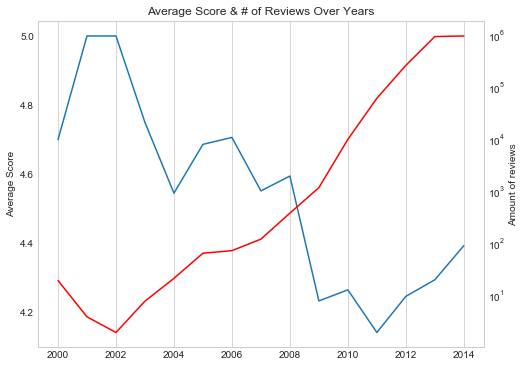

In [33]:
df_avg_score_by_year = pd.DataFrame(df_kindle_book_review.groupby(['year'])['rate'].mean())
df_amount_by_year = pd.DataFrame(df_kindle_book_review.groupby(['year'])['rate'].count())

fig = plt.figure(figsize=(8,6))
sns.set_style("whitegrid")
# Average Score over year
ax1 = fig.add_subplot(111)
ax1.plot(df_avg_score_by_year)
plt.ylabel("Average Score")
plt.grid(axis='y',b=False)

# Amount of reviews over year
ax2 = ax1.twinx()
plt.semilogy(df_amount_by_year,'r')
plt.ylabel('Amount of reviews')
plt.grid(axis='y',b=False)

plt.title('Average Score & # of Reviews Over Years')
plt.show()

**The number of reviews before 2009 is really small so we choose to calculte the annual rating breakdown beginning from 2010**

**Annual breakdown of score**

In [34]:
df_year = df_kindle_book_review[['rate','year']]
df_year_break = pd.DataFrame(df_year[df_year.year>=2010].groupby(['year','rate']).rate.count())
df_year_break = df_year_break.unstack()
df_year_break.columns = df_year_break.columns.droplevel(0)
df_year_break.columns = ['1 star','2 stars','3 stars','4 stars','5 stars']
# Calculate Percentage
df_year_break = df_year_break.apply(lambda x: x/x.sum()*100,axis=1)

data = []
for ind, rate in enumerate(df_year_break.columns):
    data.append(
        go.Bar(
            x=list(df_year_break.index),
            y=df_rate_count[rate],
            name=rate, 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = 'white',
                    width = 1),
            )
        )
    )


layout = go.Layout(
    autosize=True,
    title='Rating Breakdown Over Year',
    titlefont=dict(
        size=20
    ),
    yaxis=dict(
        type='linear',
        range=[1, 100],
        dtick=20,
        ticksuffix='%'
    ),
    barmode='stack'
)

figure = go.Figure(data=data, layout=layout)
iplot(figure, show_link=False)

**`What we have known so far:`**
1. The amount of data before 2009 is very small.
2. For average rating, the score of years before 2009 is meaningless. If we only consider rating score before 2009, we can see that the average rating goes higher every year.
3. For breakdown of scores, we merge the year before 2009 together. From the stacked plot, we can see that the distribution doesn't change much. Most of people give high socre. But recently more and more people give 5 stars which explains why the average rating goes higher recently.

#### `Topic:` Average Review Length Over Year

In [35]:
df_book_length = df_kindle_book_review.drop_duplicates(["reviewText"])
book = df_book_length.set_index('unixReviewTime')
data_book_time= []
for name, group in book.groupby(pd.Grouper(freq='A')):
    data_book_time.append(group)

for i in range(0,len(data_book_time)):
    length = []
    for j in range(0,len(data_book_time[i])):
        length.append(len(data_book_time[i]['reviewText'].iloc[j].split()))
    data_book_time[i]['length of review']=length  

length_time = {}
for i in range(0,len(data_book_time)):
    t = str(i + 2000)
    length_time[t] = len(data_book_time[i])

ave_len=[int(a['length of review'].mean()) for a in data_book_time]

In [36]:
layout = go.Layout(
    title='Average Length of Reviews Over Year',
    xaxis = dict(
        
        tickfont = dict(
            size = 10
        )
    ),
    yaxis=dict(
    ),
)
data = [go.Bar(
            x=list(length_time.keys())[-5:],
            y=ave_len[-5:],
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6']
            ),
        )]
fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)

#### `Topic:` Key Words Changing Over Year

1. Using `textprocessing` function to process the data we chosed   
2. Using `WordCloud` function from **wordcloud** library to creat wordcloud for every year.

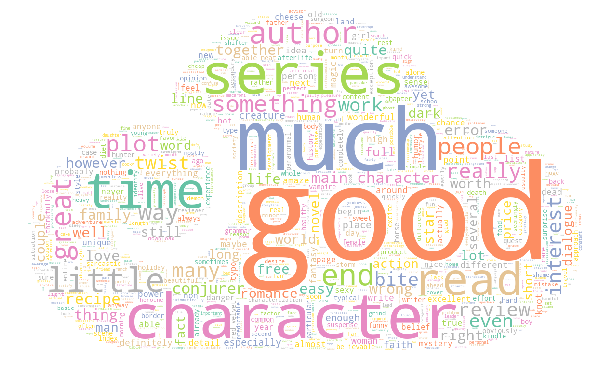

In [37]:
review_book_time,noun_time,verb_time,adj_time,adv_time= textprocessing(data_book_time)

del_word = ['book','story','will','one','two','three','four','five','want','make','take','reader','PRON']
stopword = STOPWORDS|set(del_word)

picture = imageio.imread('img/cloudPrint.png')
from ipywidgets import *
def plotworld(year):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1,1,1)    
    wordcloud = WordCloud(background_color='white',mask=picture,colormap="Set2_r",stopwords=stopword,max_words=2000,max_font_size=400,random_state=43).generate(review_book_time[year-2000])
    wordcloud.to_file('img/'+str(year)+'.png')
    plt.imshow(wordcloud)
    plt.axis("off")
plotworld(2013)
#interact(plotworld,year=(2000,2014,1))

**`What we have known so far:`**
1. We believe that reviews not only can reflect the content and people's feeling of books, but also can reflect the most popular words of each year and the type of books that readers like to read every year.
2. We may infer that the the popular words in 2014 are **good, character, new** and so on, and meanwhile we can conclude that people are more likely to read **Romance**(keywords: ***romance,love*), Arts & Photography**(keywords: **author**), **Literature & Fiction**(keywords:**character**) in 2014.

### 3.1.2 Review Analysis

#### ( a ) Relationship Between Rating and Review

#### `Topic:` Score Review Text - Sentiment Analyzer

We want to find the relationship between our review and our rating. The easiest way is to also give our review text a score which can represents whether it is positive or negative.

`NLTK` is a leading platform for building Python programs to work with human language data. In this project, we are going to use this library as our key tool for language processing.

`SentimentIntensityAnalyzer` is able to give a sentiment intensity score to sentences. The higher the score is, the more positive the sentence is. The score is normalized to a range of values between -1 and 1. In order to make it comparable with our 1-5 rate, we use linear transformation which linearly maps $(-1,1)$ to $(1,5)$:

$$reviewScoreNorm = 2\times reviewScore+3$$

We can use `reviewScoreNorm` as our predicted rate for each product.

And we calculate the difference score:

$$Diff = \left|reviewScoreNorm-Rate\right|$$

In [38]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
# Score Calculator
sid = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/suntao/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Calculate `reviewScoreNorm` and `predDiff`.

In [39]:
df_review = df_kindle_book_review[['reviewText']]
df_review = df_review.drop_duplicates(subset = 'reviewText')

# Apply score calculator on each entry.
df_review['reviewScore'] = df_review['reviewText'].apply(lambda x: sid.polarity_scores(x)['compound'])

# Merge and Reset Index
df_kindle_book_review_with_pred = pd.merge(df_kindle_book_review, df_review.reset_index(), left_on='reviewText', right_on='reviewText', how='inner')
df_kindle_book_review_with_pred = df_kindle_book_review_with_pred.set_index('asin')

# Normalize the Score
df_kindle_book_review_with_pred['reviewScoreNorm'] = df_kindle_book_review_with_pred[['reviewScore']] * 2 + 3

df_kindle_book_review_with_pred.reset_index(inplace = True)
df_kindle_book_review_with_pred.set_index('category',inplace = True)
df_kindle_book_review_with_pred.sort_index(inplace = True)

# Calculate the difference
df_kindle_book_review_with_pred['predDiff'] = abs(df_kindle_book_review_with_pred['rate'] - df_kindle_book_review_with_pred['reviewScoreNorm']) 

df_kindle_book_review_with_pred.head()

,asin,rate,price,summary,reviewText,unixReviewTime,year,reviewScore,reviewScoreNorm,predDiff
category,,,,,,,,,,
Arts & Photography,B00IZHU7NK,5.0,4.61,good intro,A really informative and clear guide on learni...,2014-03-21,2014,0.7939,4.5878,0.4122
Arts & Photography,B00K08QVEQ,4.0,8.49,Good Book!,Good tips to get yourself mentally in the righ...,2014-05-30,2014,0.9118,4.8236,0.8236
Arts & Photography,B007SANLJC,5.0,2.99,Full of great tips!,"Like all of Dan's other books, this one is ful...",2013-03-08,2013,0.8356,4.6712,0.3288
Arts & Photography,B00C11IGCK,5.0,9.73,Johnny Cash - The Legend in Black,I am not a big fan of country music however be...,2013-04-07,2013,-0.1351,2.7298,2.2702
Arts & Photography,B007SANLJC,5.0,2.99,Full of great tips!,"Like all of Dan's other books, this one is ful...",2013-03-08,2013,0.8356,4.6712,0.3288


In [40]:
df_kindle_book_review_with_pred.to_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')

#### `Analysis:`

In [41]:
df_kindle_book_review_with_pred = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')

In [42]:
df_kindle_book_review_with_pred.reset_index(inplace=True)
df_kindle_book_review_with_pred.set_index(['category'],inplace=True)

**The distribution of the error between predicted and real score.**

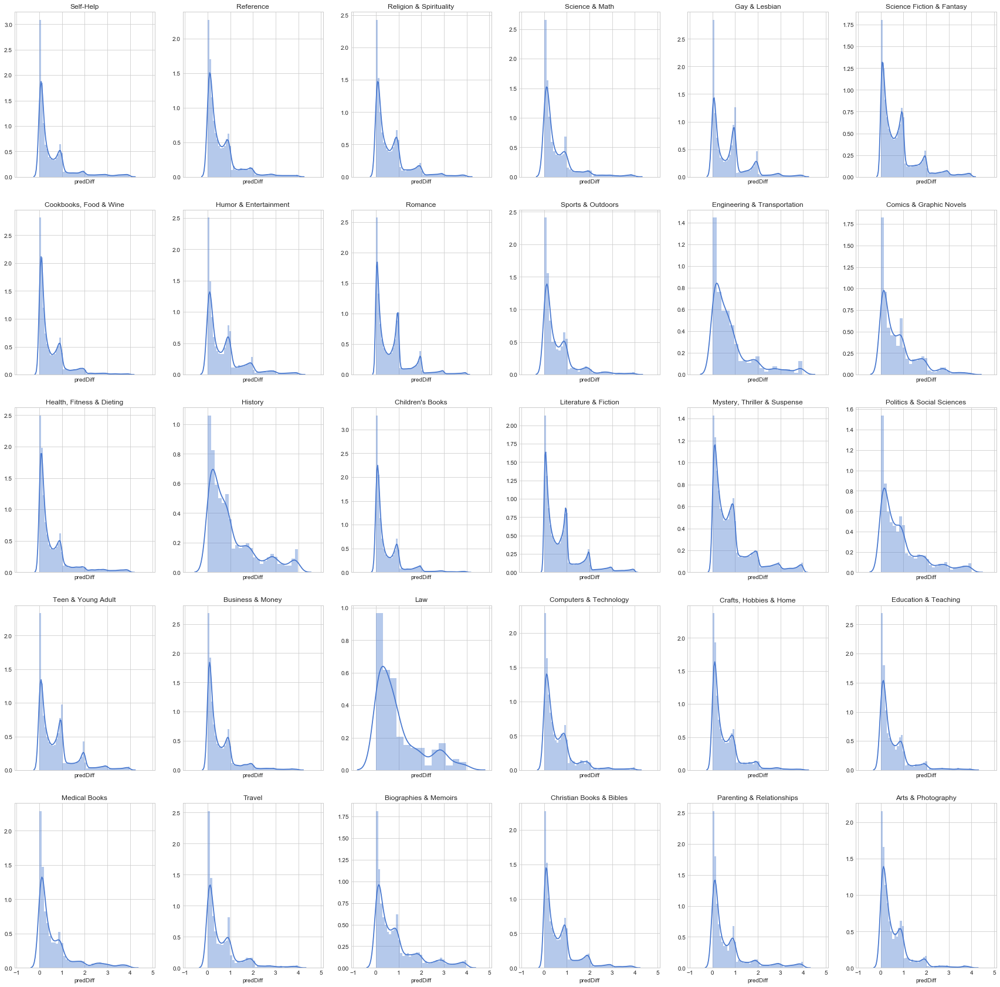

In [43]:
categories = list(set(df_kindle_book_review_with_pred.index))
categories_matrix = np.array(categories).reshape(5,6)
f, axes = plt.subplots(5, 6, figsize=(30,30), sharex=True)
sns.set(style="white", palette="muted", color_codes=True)
for i in range(5):
    for j in range(6):
        axes[i,j].set_title(categories_matrix[i,j])
        sns.distplot(df_kindle_book_review_with_pred[df_kindle_book_review_with_pred.index == categories_matrix[i,j]]['predDiff'], color="b",ax=axes[i,j])

**The distribution of the predicted score of each rating group.**

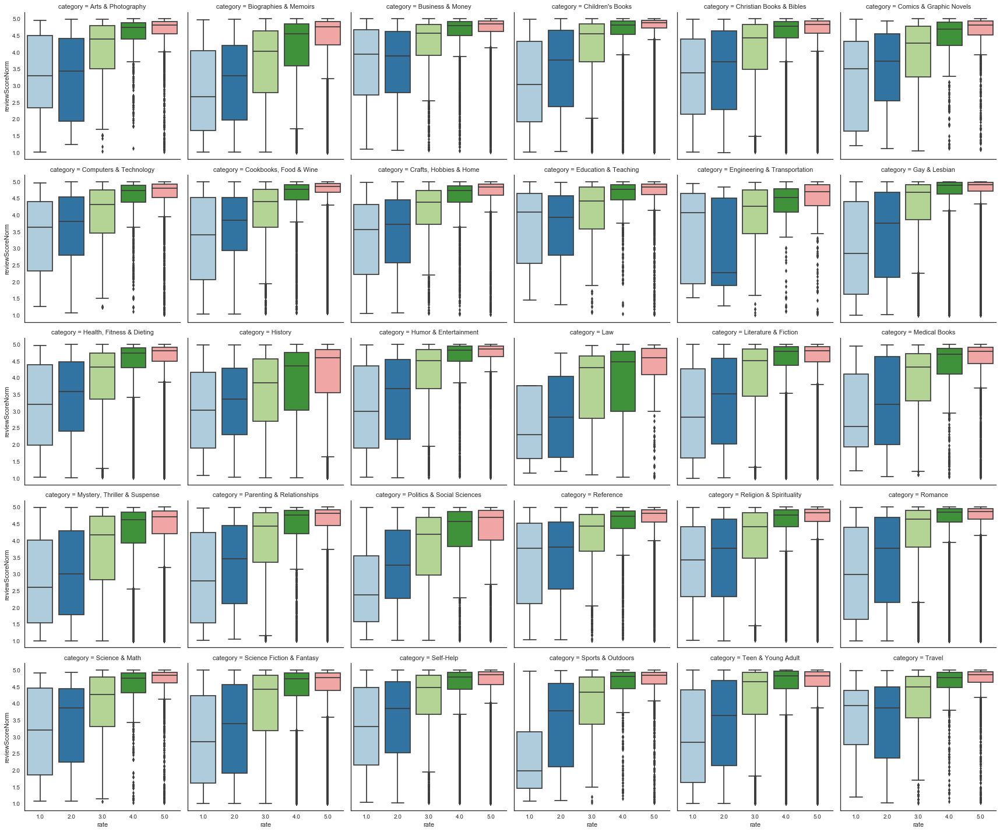

In [44]:
sns.factorplot(x='rate', 
               y='reviewScoreNorm', 
               data=df_kindle_book_review_with_pred.reset_index(), 
               col='category',  
               col_wrap=6,
               kind='box',
               palette="Paired")

**Consider the number of books of each category.**

In [45]:
df_re = pd.DataFrame()
df_re['amount'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred.index])['rate'].count()
df_re['real_avg'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred.index])['rate'].mean()
df_re['pred_avg'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred.index])['reviewScoreNorm'].mean()

hover_text = []
for index, row in df_re.iterrows():
    hover_text.append(('{category}<br>'+
                      'Amount: {amount}<br>'+
                      'Real Score: {real}<br>'+
                      'Predicted Score: {pred}<br>').format(category=index,
                                            amount=row['amount'].round(2),
                                            real=row['real_avg'].round(2),
                                            pred=row['pred_avg'].round(2)))


trace0 = go.Scatter(
    x=df_re['real_avg'].round(2),
    y=df_re['pred_avg'].round(2),
    mode='markers',
    marker=dict(
        size=df_re['amount'],
        sizemode='area',
        sizeref=max(df_re['amount'])/(50.**2),
        sizemin=4
    ),
    text = hover_text,
    name = ''
)

trace1 = go.Scatter(
    x = [4.2,4.6],
    y = [4.2,4.6],
    mode = 'lines',
    line = dict(
        color = ('rgb(205, 12, 24)'),
        width = 1.5,
        dash = 'dot'),
    name = 'Truth=Predicted'
)

layout = go.Layout(
    autosize = False,
    width=800,
    height=500,
    title='How accurate the prediction is for each category?',
    xaxis=dict(
        title='Average Real Score',
    ),
    yaxis=dict(
        title='Average Predicted Score',
    ),
    showlegend= False  
)

data = [trace0,trace1]

fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)
#py.iplot(fig, filename='RealvsPred')

**`What we have known so far:`**
1. We give each review text a sentiment score and normalize it to our 1-5 score as our predicted score, and then we compare it with the real score.
2. From the **Distribution plot of Difference**, we can see that the predicted score is really good since the difference for most of category is small.
3. From the **Volin/Box plot for real v.s. predictive rating score by category**, we can get that for each category high real score will get a high predicted score. In other words, if someone gives high rate then his/her review is more like to have lots of positive words.
4. From the **Scatterplot**, we see that predicted scores of thoes categories of large amount is more accurate which seems to make sense because we have a larger amount of samples.

#### `Topic:` Count Punctuation and Part of Speech
What’s the style of each rating groups of reviewers? To explain this, for each rating, we calculate the average percentage of adjective, adverb, noun, verb as well as exclamation point and question mark which are both highly relevant with people’s feelings. And then scale them to 0-1 for comparing.

In [46]:
# How we get the number of words of each rating is omitted here.
df_data_array = []
df_data_array.append(pd.read_pickle('data_rate/data_book_rate1'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate2'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate3'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate4'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate5'))

In [47]:
# Calculate the percentage of usage of each type of words
def get_info(df):
    df_info=pd.DataFrame()
    df_info['Adj']  = df['Adj']/df['length of review']
    df_info['Adv']  = df['Adv']/df['length of review']
    df_info['Noun'] = df['Noun']/df['length of review']
    df_info['Verb'] = df['Verb']/df['length of review']
    df_info['Signal_ex'] = df['Signal_ex']/df['length of review']
    df_info['Signal_qu'] = df['Signal_qu']/df['length of review']
    return df_info.apply(np.mean,axis=0)

In [48]:
df_all = pd.DataFrame()
for ind, df in enumerate(df_data_array):
    df_all[ind+1]=get_info(df)

# Treat the max as 1 to scale all percentage into 0-1
df_all = df_all.apply(lambda x: (x/x.max()),axis=1)
df_all = df_all.round(2)

df_all.index = ['Adj','Adv','Noun','Verb','Ex - !','Q - ?']

data = []
for ind, rate in enumerate([1,2,3,4,5]):
    data.append(
        go.Bar(
            x=list(df_all.index),
            y=df_all[rate],
            name='Rate '+str(rate), 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = (color_list[ind]),
                    width = 3),
            )
        )
    )
layout = go.Layout(
    autosize=True,
    title='Relative Weight of Each Type',
)
fig = go.Figure(data=data,layout=layout)
iplot(fig,show_link=False)

Use Radar Chart to show the difference in another way.

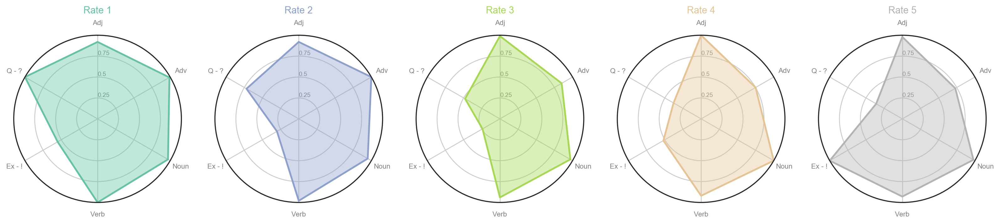

In [49]:
# Reference: https://python-graph-gallery.com/392-use-faceting-for-radar-chart/

from math import pi

# ------- PART 1: Define a function that do a plot for one line of the dataset!
 
def make_spider( col, title, color):
 
    # number of variable
    categories=list(df_all.index)
    N = len(categories)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    # Initialise the spider plot
    ax = plt.subplot(1,5,col+1, polar=True, )

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='grey', size=8)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([0.25,0.5,0.75], ["0.25","0.5","0.75"], color="grey", size=7)
    plt.ylim(0,1)

    # Ind1
    values=df_all[col+1].values.flatten().tolist()
    values += values[:1]
    ax.plot(angles, values, color=color, linewidth=2, linestyle='solid')
    ax.fill(angles, values, color=color, alpha=0.4)

    # Add a title
    plt.title(title, size=11, color=color, y=1.1)

# ------- PART 2: Apply to all individuals
# initialize the figure
plt.figure(figsize=(20,10),dpi=200)
# Create a color palette:
my_palette = plt.cm.get_cmap("Set2", len(df_all.columns))
 
# Loop to plot
for col in range(0, len(df_all.columns)):
    make_spider(col=col, title='Rate '+ str(df_all.columns[col]), color=my_palette(col))

#### `What we have known so far:` 

1. For **exclamation point**, 5-star reviewers love to use it.
2. For **question mark**, 1-star reviewers love to use it. 
3. For **adverb**, the lower the score is, the more the adverb is. 
4. For **adjective and verb**, high score group use more adjectives while low score group like to use more verbs. 
5. For **noun**, the difference is not that clear.


#### `Topic:` High-Frequency Vocabulary Statistics for Each Part Of Speech

In [50]:
# We collect the Top-50 high-frequency words used in each rating group
# The process is omitted here.

df_r1 = pd.read_pickle('pickleDataNew/Rate1freq')
df_r2 = pd.read_pickle('pickleDataNew/Rate2freq')
df_r3 = pd.read_pickle('pickleDataNew/Rate3freq')
df_r4 = pd.read_pickle('pickleDataNew/Rate4freq')
df_r5 = pd.read_pickle('pickleDataNew/Rate5freq')

df_hfarray = [df_r1, df_r2, df_r3, df_r4, df_r5]

# That's how the DataFrame is like
df_r1.head()

,Noun,Noun_freq,Verb,Verb_freq,Adj,Adj_freq,Adv,Adv_freq
0,book,275,be,1032,-PRON-,248,not,366
1,story,159,have,216,that,69,just,103
2,character,84,do,177,good,67,there,101
3,author,67,read,134,other,48,so,70
4,what,65,get,89,free,44,really,60


In [51]:
def intersection(df_array, t):
    r = []
    for i in range(5):
        r.append(set(df_array[i][t].values))
    print(r[0]&r[1]&r[2]&r[3]&r[4])    

In [52]:
for t in ['Noun','Verb','Adj','Adv']:
    print('High-Frequency '+t+' of All Ratings:')
    intersection(df_hfarray, t)
    print('')

High-Frequency Noun of All Ratings:
{'book', 'character', 'people', 'what', 'time', 'series', 'thing', 'story', 'novel', 'lot', 'author', 'way', 'romance', 'woman', 'man', 'life', 'one', 'scene', 'end', 'who', 'love'}

High-Frequency Verb of All Ratings:
{'will', 'be', 'read', 'look', 'could', 'enjoy', 'leave', 'know', 'keep', 'make', 'go', 'find', 'come', 'feel', 'have', 'think', 'get', 'say', 'like', 'give', 'should', 'do', 'can', 'see', 'try', 'recommend', 'write', 'start', 'would', 'want', 'tell', 'love', 'take'}

High-Frequency Adj of All Ratings:
{'worth', 'good', 'long', 'such', 'little', 'short', 'that', 'other', 'interesting', 'first', 'hot', 'few', 'new', 'more', 'which', 'much', 'many', 'different', 'all', 'free', '-PRON-', 'great'}

High-Frequency Adv of All Ratings:
{'together', 'almost', 'back', 'however', 'still', 'now', 'only', 'away', 'just', 'too', 'very', 'first', 'well', 'really', 'also', 'more', 'even', 'much', 'again', 'there', 'so', 'why', 'then', 'all', 'not', '

#### `What we have known so far:` 

1. Positive words like good, great are high-frequency words in all 5 levels. However, common negative words like bad, worse are not presented in the table.
2. After sampling some 1 and 2-stat reviews which contains the positive word "good". 6 out of 10 of them are totally positive or neutral, there isn’t any negative adverb like 'not'. Therefore, we can roughly claim that the sentiment of reviews are not positively correlative with the rating score, which perhaps leads a imprecise result for review’s sentiment analysis.

#### `Topic:` Sentiment Analysis with Machine Learning

As we have found that the review can give us a very reasonable predicted rating score compared to the real one, we decide to classify our review and train a prediction model for Amazon review, which means that we can generate a rating score automatically according to one’s review. 

Sentiment analysis is a natural language processing method that allows us to obtain the general sentiment or “feeling” on some text. In order to implement this classification, we choose to use **fastText** text classification for our sentiment analysis. FastText is an open-source, free, lightweight library created by FacebookResearch that allows users to learn text representations and text classifiers and we trained a supervised learning model with it.

In [53]:
import fasttext

In this task, we choose to do classificaiton on **only two categories**, good reviews of rating 5 and bad reivews of rating 1-4.

In [58]:
df_kindle_book_review = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')
df_kindle_book_review.drop_duplicates(['reviewText'],inplace=True)
df_kindle_book_review = df_kindle_book_review[['reviewText','rate']]
df_kindle_book_review = df_kindle_book_review.reset_index()
df_kindle_book_review.drop(['category'],axis=1,inplace=True)
df_kindle_book_review['rate'] = df_kindle_book_review['rate'].astype(int)

# map 1 2 3 to 4
df_kindle_book_review['rate'] = df_kindle_book_review['rate'].apply(lambda x: 4 if x in [1,2,3] else x)

# Use 900000 reviews and corresponding rate as training group
df_train = df_kindle_book_review.iloc[:900000]
print("The number of reviews for each rate:")
print(df_train['rate'].value_counts())

# Use 10000 reviews as testing group
df_test = df_kindle_book_review.iloc[900000:910000]
df_test = df_test.reset_index()
df_test.drop(['index'],axis=1,inplace=True)

The number of reviews for each rate:
5    507984
4    392016
Name: rate, dtype: int64


**Pre-processing and load data after pre-processing**

Before train our model with the training data, we first did some data cleaning and preprocessing work.

Here is a list of preprocessing that we did for our review text:

- Expand contraction word
- Remove repetitions
- Spelling correction
- Emphasize sentiment words
- Remove digits

As it takes too much to do this preprocess precedure, we did this part on Google cloud platform and download directly the final pickle files from the site. 

In [59]:
df_train_clean = pd.read_pickle('pickleDataNew/train_after_preprocess.pkl')
df_test_clean = pd.read_pickle('pickleDataNew/test_after_preprocess.pkl')
key = df_test_clean['rate'].values
df_test_clean.drop(['rate'],axis=1,inplace=True)

**Build classification model**

At the very beginning, we tried to classify our reviews into 5 classifiers just like the 5 rating level defined by Amazon. Nevertheless, we couldn’t obtain a rational accuracy no matter how we preprocess our data or modify our training model.

With curiosity, we had a look at serval review content, we found that we can hardly distinguish the reviews for rating score between 1-4. Hence, we decided to classify reviews only into 2 classifiers, we assigned all the 1-4 rating score's reviews into the same classifier.

In [60]:
def create_fasttext_train_file(train):
    f = open('fasttext_train.txt','w')
    for tweet, sentiment in zip(train['reviewText'], train['rate']):
        f.write((tweet.rstrip() + ' ' + sentiment + '\n'))
    f.close()

def fast_text(train, test):
    train['rate'] = train['rate'].apply(lambda row: '__label__'+str(row))

    create_fasttext_train_file(train)
    classifier = fasttext.supervised('fasttext_train.txt', 'fasttext_model',
                                     label_prefix='__label__',epoch = 50,
                                     dim = 200,ws = 5,lr = 0.05)

    test = np.array(test['reviewText'])
    labels = classifier.predict(test)
    labels = [int(value) for label in labels for value in label]
    return labels

**Fit model and prediction**

Initially we don’t do any preprocessing work and fit reviews directly into our model, the prediction accuracy is only 63%. After several data cleaning and preprocessing work, our accuracy improve up to 75%.

In [61]:
pred = fast_text(df_train_clean, df_test_clean)
pred = np.array(pred)
print("Prediction accuracy is: {}%".format(round(np.sum(key == pred)/10000,2)*100))

Prediction accuracy is: 75.0%


**`What we have known so far:`**

1. We admit that our result is not accurate enough. From our point of view, the main cause which leads to this accuracy level is the diversity of personal measuring standard.

2. With the help of previous analysis, we found the personal measuring standard is quite diverse among customer. For instance, some customers always give a 5 rating score for one product even if they are not totally satisfied with it, which means that they may add some negative words in full rating score reviews.

3. In order to conduct a more profound research on review classification, we plan to construct neural network models to improve the prediction accuracy in the future.

#### ( b ) Relationship between category and review

#### `Topic:`  Key Word of Category

In this part, we want to find out the key words in the reviews of each category. Considering that we have 30 different categories in the dataset and there also exist some overlaps. So, we decide to use only **six** of them which are mostly likely not overlapping.


1. Since each book can belong to several categories, so choosing some categories with less overlap will be benificial for us to analyse and compare with each category.   
2. we fistly compute the number of duplicate reviews between different categories using function `intersection`.
3. Then we use **heatmap** to show the confusion matrix of categories, and since the values of confusion matrix are huge different with each other, we use the **log** values to draw heatmap.

In [63]:
df_kindle_book_review = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')
data_book=[]
key = []
for name, group in df_kindle_book_review.groupby("category"):
    key.append(name)
    data_book.append(group)

In [64]:
repeat = {}
m = len(key)
matrix = np.zeros([m,m])
for i in range(0,m):
    for j in range(0,m):
        count = 0 
        a = data_book[i]['summary'].values
        b = data_book[j]['summary'].values
        count = len(list(set(a).intersection(set(b))))
        matrix[i][j] = count
        repeat[key[i]+' VS '+key[j]]=count
matrix_log = np.log(matrix).round(2)

layout = go.Layout(
    autosize = False,
    width=800,
    height=800,
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 5
        )
    ),
    yaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 5
        )
    ),
)        
        
trace = [go.Heatmap(z=matrix_log.tolist(),
                    x=key,
                    y=key,
                    colorscale='YlGnBu',
                    opacity=0.8
                  )]
fig = go.Figure(data=trace, layout=layout)
iplot(fig,show_link=False)
#py.iplot(fig, filename='confusion_matirxs_heatmap',layout=layout)

   According to the **heatmap** we draw above, we manually select six categories which have only small duplicated reviews number with each others in the premise of retaining as much reviews as possible. 

And then we also show the duplicated reviews confution matrix between selected categories through **heatmap**.

In [65]:
Repeat = {}
keys = ['Romance',"Children's Books",'Business & Money','Biographies & Memoirs','Crafts, Hobbies & Home','Health, Fitness & Dieting']   
n= len(keys)
Matrix = np.zeros([n,n])
for i in range(0,n):
    for j in range(0,n):
        count = 0 
        a = data_book[i]['summary'].values
        b = data_book[j]['summary'].values
        count = len(list(set(a).intersection(set(b))))
        Matrix[i][j] = int(count)
        Repeat[keys[i]+' VS '+keys[j]]=count
Matrix_log = np.log(Matrix).round(2)        

layout = go.Layout(
    autosize = False,
    width=400,
    height=400,
    xaxis=dict(
        tickfont=dict(
            size=10,
        ),
    ),
    yaxis=dict(
        showticklabels=False
    ),
    title='Overlapping Between Chosen Categories',
    titlefont=dict(
        size=15
    )
)        
        
trace = [go.Heatmap(z=Matrix_log.tolist(),
                    x=keys,
                    y=keys,
                    colorscale='YlGnBu',
                    opacity=0.8,
                  )]
fig = go.Figure(data=trace, layout=layout)
iplot(fig,show_link=False)
#py.iplot(fig, filename='confusion_matirx_heatmap',layout=layout)

The number reviews of **Romance** is 281000, **Children's Book** is 28000, **Business & Money** is 14000,**Biographies & Memoirs** is 7000, **Crafts,Hobbies & Home** is 10000 and **Health,Fitness & Dieting** is 26000. So, with the help of the confusion matrix, we can find that the six categories we choose have a small number of overlaps which can be ignored considering the size of each category.

According to the chosen categories we select the corresponding data from original data.

In [67]:
df_kindle_book_review.reset_index(inplace=True)
df_book_class = df_kindle_book_review[df_kindle_book_review['category'].isin(key)]
data_book_class= []
category=[]
for name, group in df_book_class.groupby("category"):
    data_book_class.append(group)
    category.append(name)

1. Using `textprocessing` function to process the data we chosed   
2. Using `WordCloud` function from **wordcloud** library to creat wordcloud for each category.

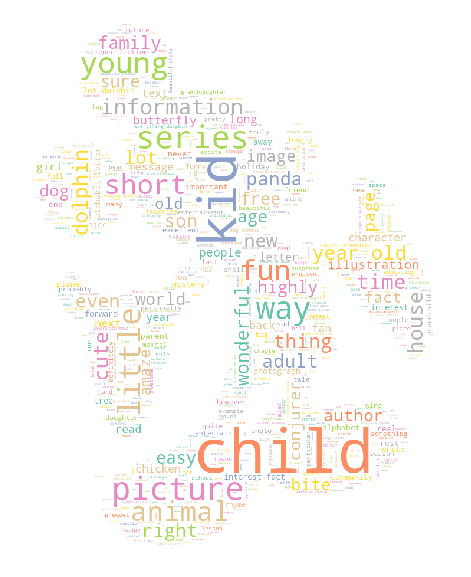

In [68]:
review_book_class,noun_class,verb_class,adj_class,adv_class = textprocessing(data_book_class)

del_word = ['book','story','will','one','two','three','four','five','want','make','take','reader','PRON']

del_word += ['really','good','great','much'] # These two are in every word cloud and thus we don't want to see them!

for word in del_word:
    stopword = STOPWORDS.add(word)
def plotworld(keys):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1,1,1)    
    i = category.index(keys)
    picture = imageio.imread('img/'+keys+'_mask.jpg')
    wordcloud = WordCloud(background_color='white',mask=picture, colormap="Set2_r",stopwords=stopword,max_words=2000,max_font_size=400,random_state=43).generate(review_book_class[i])
    wordcloud.to_file('img/'+keys+'.png')
    plt.imshow(wordcloud)
    plt.axis("off")
keys = ['Romance',"Children's Books",'Business & Money','Biographies & Memoirs','Crafts, Hobbies & Home','Health, Fitness & Dieting']   

# For some reasons, we cannot display wordcloud of all 6 categories, so here we only plot one of them. 
#interact(plotworld,keys=keys)
plotworld("Children's Books")

**`What we have known so far:`**
1. It is clear that reviews are closely related to the type of book.
2. For **Romance**, we can find that the words **character**, **love** are used more frequently.
3. For **Children's Book**, the most remarkable words are **interesting**, **tale**.
4. It is common to find that the keywords of **Business & Money** are **author**, **information**, **money**.
5. When reading **Biographies & Memoir**, we can have a deep impression on author through the their **life** and the growth of the **family** environment.
6. It is interesting to find that when talking about **Crafts, Hobbies & Home**, which have keywords as **dog**, **recipe**, **idea**.
7. It makes sense that **life** and **health** are used more frequently in **Health, Fitness & Dieting**.

---

## 3.2 Kindle Short Reads

Arising from 2014, Short Reads now takes up almost one quarter of all available English Kindle titles on Kindle market.

There have been a lot of discussions on the topics of short reads, the book page lengths as well as the price. Let’s have a look at some recent opinions and facts.

In [69]:
df_short = pd.read_pickle('pickleDataNew/kindle_short_read_review.pkl')

In [70]:
cat_list = ['15 minutes (1-11 pages)','30 minutes (12-21 pages)',
            '45 minutes (22-32 pages)','One hour (33-43 pages)',
            '90 minutes (44-64 pages)','Two hours or more (65-100 pages)']

### 3.2.1 Rating Study

**`OPINION`: Nowadays, reader loves short reads?**

In this part, we are going to expolre whether this is opinion holds.

**`FACT-1`: From the Perspective of Year** 

In [71]:
df_short['year'] = df_short['unixReviewTime'].apply(lambda x: x.year)
df_short_rating = df_short.reset_index().groupby(['category','year']).agg({'rate': [np.mean,np.median,np.count_nonzero],"asin":[lambda x: len(set(x))]})
df_short_rating.columns = ['avg_rate','med_rate','#review','#book']
df_short_rating['avg_review'] = df_short_rating['#review']/df_short_rating['#book']
df_short_rating.head(6)

avg_rate  med_rate  #review  #book  avg_review
category                year                                                
15 minutes (1-11 pages) 2009  4.000000       4.0      5.0      1    5.000000
                        2010  4.750000       5.0      4.0      3    1.333333
                        2011  3.909408       4.0    287.0     73    3.931507
                        2012  4.010574       4.0    662.0    151    4.384106
                        2013  4.029581       4.0   1217.0    226    5.384956
                        2014  4.096774       5.0    651.0    182    3.576923

**There are only a few reads and reviews/rates before 2011. So, we only consider reads and reviews/rates after 2011.**

In [72]:
df_short_rating.reset_index(inplace=True)
df_short_rating = df_short_rating[df_short_rating.year>=2011]
df_short_rating.set_index('category', inplace=True)
df_short_rating.head()

,year,avg_rate,med_rate,#review,#book,avg_review
category,,,,,,
15 minutes (1-11 pages),2011,3.909408,4.0,287.0,73,3.931507
15 minutes (1-11 pages),2012,4.010574,4.0,662.0,151,4.384106
15 minutes (1-11 pages),2013,4.029581,4.0,1217.0,226,5.384956
15 minutes (1-11 pages),2014,4.096774,5.0,651.0,182,3.576923
30 minutes (12-21 pages),2011,3.984848,4.0,924.0,213,4.338028


**Number of Review + Average Rating Over Year **

In [73]:
fig = tls.make_subplots(rows=1, cols=2, shared_xaxes=True, subplot_titles=('Average Number of Reviews','Average Rating'))

for ind, cat in enumerate(cat_list):
    fig.append_trace(
        go.Scatter(
            x=[2011,2012,2013,2014],
            y=df_short_rating.loc[cat]['avg_review'].values.round(2),
            name=cat,
            line = dict(
                color = (color_list[ind]),
                width = 3),
            legendgroup=cat,
        ),
        1,1
    )
    fig.append_trace(
        go.Scatter(
            x=[2011,2012,2013,2014],
            y=df_short_rating.loc[cat].avg_rate.values.round(2),
            name=cat,
            line = dict(
                color = (color_list[ind]),
                width = 3),
            showlegend = False,
            legendgroup=cat,
        ),
        1,2
    )
    
fig.layout['legend']=dict(
    orientation="h", 
    y=1.2,
    font=dict(
        size=7,
    ),
)
#py.iplot(fig, filename='SR_#Re+AvgRe')
iplot(fig, show_link=False)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



**`DESCRIPTION:`**

Reader satisfaction, as expressed by book review ratings increases with the length of the book; conversely, average ratings drop the shorter the book — at least in the Short Reads segment. So does the sales of books, which are roughly approximated by the number of reviews collected in the dataset.

**`FACT-2`: From the Perspective of Category** 

In [74]:
df_short_rate_distri = df_short.groupby(['category','rate']).count().price
df_short_rate_distri = pd.DataFrame(df_short_rate_distri)
df_short_rate_distri = df_short_rate_distri.unstack(level=0)
df_short_rate_distri.columns = df_short_rate_distri.columns.droplevel(0)
# Calculate Percentage
df_short_rate_distri = df_short_rate_distri/df_short_rate_distri.sum()*100
df_short_rate_distri = df_short_rate_distri.T
df_short_rate_distri = df_short_rate_distri.round(2)
df_short_rate_distri

rate,1.0,2.0,3.0,4.0,5.0
category,,,,,
15 minutes (1-11 pages),4.49,5.91,17.41,26.54,45.65
30 minutes (12-21 pages),2.99,5.04,13.42,26.16,52.38
45 minutes (22-32 pages),2.07,3.66,10.35,23.39,60.53
90 minutes (44-64 pages),1.95,3.52,11.43,25.69,57.41
One hour (33-43 pages),2.02,3.63,10.04,24.25,60.06
Two hours or more (65-100 pages),1.56,3.14,11.67,26.84,56.79


In [75]:
data = []
for ind, rate in enumerate([1,2,3,4,5]):
    data.append(
        go.Bar(
            x=['15 min','30 min', '45 min', '90 min', '1 hour', '2 hours'],
            y=df_short_rate_distri[rate],
            name='Rate '+str(rate), 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = (color_list[ind]),
                    width = 3),
            )
        )
    )
layout = go.Layout(
    autosize=True,
    title='Rating Breakdown of Short Read',
    titlefont=dict(
        size=20
    ),
    yaxis=dict(
        type='linear',
        range=[1, 100],
        dtick=20,
        ticksuffix='%'
    ),
    barmode='stack'
)
fig = go.Figure(data=data,layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

As what we have learnt from the book store, most of the reviewers are all very kind to give 4 or 5 star and only less than a quarter of them score the book three star or even lower. However, despite of this general truth, 15-minutes short reads are also not that welcomed with only less than a half of ratings of 5 star.

**`CONCLUSION:`**
   
**Q: Nowadays, reader loves short reads?**

**A: Not Really.**


### 3.2.2 Length of Review Study

**`OPINION`: Short reads leads to short review? **

In this part, we are going to expolre whether this is opinion holds.

In [76]:
df_short_review = df_short.reset_index()[['category','rate','reviewText']]
# Calculate the Review Length
df_short_review['reviewLen'] = df_short_review.reviewText.apply(lambda x: len(x.split(' ')))
df_short_review.head()

,category,rate,reviewText,reviewLen
0,Two hours or more (65-100 pages),5.0,Really shouldn't have Han Solo on the cover as...,35
1,Two hours or more (65-100 pages),3.0,Originally published as an e-book coinciding w...,282
2,Two hours or more (65-100 pages),3.0,This book was a good idea. I have always wante...,42
3,Two hours or more (65-100 pages),5.0,Great short story. It gives a little more insi...,21
4,Two hours or more (65-100 pages),5.0,I love anything with Chewbacca in it. Him and...,28


**`FACT-1`: Length Distribution** 

In [77]:
df_short_review_len = df_short_review.set_index(['category'])[['rate','reviewLen']]
df_short_review_len.sort_values(by='rate',inplace=True,ascending=True)

data = []
for ind,cat in enumerate(cat_list):
    data.append(
        go.Box(
            x=df_short_review_len.loc[cat].rate.values,
            y=df_short_review_len.loc[cat].reviewLen.values,
            name=cat,
            marker = dict(color=(color_list[ind]))
        )
    )

layout = go.Layout(
    title='Length of Review Distribution',
    titlefont=dict(
        size=20
    ),
    yaxis=dict(
        title='Length of Review',
        range=[0,2000],
        zeroline=False
    ),
    boxmode='group',
    legend=dict(
        orientation="h", 
        y=1.1,
        font=dict(
            size=5,
        ),
    ),
)
fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

As the length of the book increases, there are going to be more and more active and “serious” reviewers who wrote extreme long reviews. People love to write longer review after finishing longer readings, which of course makes senses.

**`FACT-2`: Mean And Median Study** 

In [78]:
df_short_review_len_mean = df_short_review_len.reset_index().groupby(['category','rate']).mean()
df_short_review_len_mean.reset_index(inplace=True)
df_short_review_len_mean.set_index('category',inplace=True)

df_short_review_len_med = df_short_review_len.reset_index().groupby(['category','rate']).median()
df_short_review_len_med.reset_index(inplace=True)
df_short_review_len_med.set_index('category',inplace=True)

fig = tls.make_subplots(rows=1, cols=2, shared_xaxes=True, subplot_titles=('Average Length','Median Length'))

for ind, cat in enumerate(cat_list):
    fig.append_trace(
        go.Scatter(
            x=df_short_review_len_mean.loc[cat].rate.values,
            y=df_short_review_len_mean.loc[cat].reviewLen.values.round(2),
            name=cat,
            legendgroup=cat,
            line = dict(
                color = (color_list[ind]),
                width = 3),
        ),
        1,1
    )
    fig.append_trace(
        go.Scatter(
            x=df_short_review_len_med.loc[cat].rate.values,
            y=df_short_review_len_med.loc[cat].reviewLen.values,
            name=cat,
            legendgroup=cat,
            showlegend = False,
            line = dict(
                color = (color_list[ind]),
                width = 3),
        ),
        1,2
    )
    
fig.layout['legend']=dict(
    orientation="h", 
    y=1.2,
    font=dict(
        size=7,
    ),
)

iplot(fig, show_link=False)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



**`DESCRIPTION:`**

Longer reads does lead to longer review. But, the mean length is much longer than median length and the difference of the median is not that clear as that of mean.

**`CONCLUSION:`**
   
**Q: Short reads leads to short review??**

**A: Sounds Right.**

### 3.2.3 Price Study

**`OPINION:` Price plays an important role?**

In this part, we are going to expolre whether this is opinion holds.

In [79]:
df_short_price = df_short[df_short.year>=2012][['rate','price','year']]
df_price = df_short_price.reset_index()[['asin','price']].drop_duplicates()

In [80]:
df_price.price.value_counts().sort_values(ascending=False).head(10)

2.99    4636
0.99    4270
0.00    2339
3.99    1352
4.99     632
1.99     582
9.99     418
5.99     246
6.95     245
7.99     191
Name: price, dtype: int64

In [81]:
pd.Series(df_price.price.value_counts().index.values).describe()

count    445.000000
mean       7.802944
std        5.368220
min        0.000000
25%        3.960000
50%        6.870000
75%        9.970000
max       39.990000
dtype: float64

In [82]:
price_labels = ['0-1', '1-2', '2-3', '3-4', '4-5', '5-6', '6-7', '7-8','8-9','9-10','>10']
price_range = [0,1,2,3,4,5,6,7,8,9,10,np.inf]
df_price['price_group'] = pd.cut(df_price.price, price_range, right=True, labels=price_labels)
df_short_price['price_group'] = pd.cut(df_short_price.price, price_range, right=True, labels=price_labels)

**`FACT-1:` Price vs Rating**

In [83]:
trace1=go.Bar(
    x=list(df_price.groupby(['price_group']).size().index),
    y=df_price.groupby(['price_group']).size().values,
    name='Num of Reads',
    marker=go.Marker(color='#0175D8')
)
trace2=go.Scatter(
    x=list(df_short_price.groupby(['price_group']).mean().index),
    y=df_short_price.groupby(['price_group']).mean().rate.values.round(2),
    name='Average Rating',
    yaxis='y2',
    line = dict(
        color = ('#C30C18'),
        width = 3)
)
data=[trace1,trace2]
layout=go.Layout(
    title='Price/Rating of Short Reads',
    titlefont=dict(
        size=20
    ),
    xaxis=dict(
        title='Price'
    ),
    yaxis=dict(
        title='Number of Short Reads',
        showgrid=False,
    ),
    yaxis2=dict(
        title='Average Rating',
        overlaying='y',
        showgrid=False,
        side='right'
    ),
    legend=dict(
        orientation="h", 
        x=.7,
        y=1.1,
    ),
)
fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

Higher price results in higher score, which is a little doubtable conclusion as we have fewer data in high price groups. But, one thing is for sure, low price does not lead to high average ratings, and people maybe are more care about the value of books not only the value of money.

**`FACT-2`: Price vs Review**

In [84]:
df_short['price_group'] = pd.cut(df_short.price, price_range, right=True, labels=price_labels)
df_short_review_price = df_short.reset_index()[['price_group','reviewText']]
df_short_review_price['reviewLen'] = df_short_review_price.reviewText.apply(lambda x: len(x.split(' ')))

In [85]:
trace1=go.Bar(
    x=list(df_short_review_price.groupby('price_group').size().index),
    y=df_short_review_price.groupby('price_group').size().values,
    name='Numer of Reviews',
    marker=go.Marker(color='#0175D8'),
)
trace2=go.Scatter(
    x=list(df_short_review_price.groupby('price_group').reviewLen.median().index),
    y=df_short_review_price.groupby('price_group').reviewLen.median().values.round(2),
    name='Median Length',
    yaxis='y2',
    line = dict(
        color = ('#C30C18'),
        width = 3),
)
data=[trace1,trace2]
layout=go.Layout(
    title='Reviews of Short Reads',
    titlefont=dict(
        size=20
    ),
    xaxis=dict(
        title='Price'
    ),
    yaxis=dict(
        title='Number of Reviews',
        showgrid=False,
    ),
    yaxis2=dict(
        title='Median Length of Reviews',
        overlaying='y',
        showgrid=False,
        side='right'
    ),
    legend=dict(
        orientation="h", 
        x=.7,
        y=1.1,
    ),
)
fig = go.Figure(data=data, layout=layout)
#py.iplot(fig, filename='SR_PrReLen')
iplot(fig,show_link=False)

**`DESCRIPTION:`**

From the perspective of median length of review, lower price leads to shorter length of reviews and in general the reviewers are willing to write long review for high price. But, after all, there are always personal influences behind it. We cannot draw any easy conclusion here.

**`CONCLUSION:`**

**Q: Price plays an important role?**

**A: It's tricky to answer.**